#**Grande Epidemia di Primavera**

##INIZIALIZZAZIONE E FUNZIONI UTILI

In [ ]:
%%capture
!   pip install adjustText
from adjustText import adjust_text
import networkx as nx
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
import random

import google.colab.drive
google.colab.drive.mount('/content/drive')
warnings.filterwarnings("ignore")

# Carica i dati
df = pd.read_csv('/content/drive/MyDrive/social_network/got_new/nodi_statistiche.csv')

In [ ]:
# GraphML: crea un grafo
G = nx.read_graphml("/content/drive/MyDrive/social_network/got_temp/got.graphml")
random.seed(19)

Ecco un confronto tra i due scenari di epidemia (Peste Nera e COVID-19), usando i parametri storici e scientifici conosciuti:

---

### Parametri Simulazione

1. **Peste Nera**:
   - **Probabilità di contagio**: Alta (`0.3`) — La peste si diffondeva rapidamente in ambienti densamente popolati.
   - **Tasso di mortalità**: Molto alto (`0.5`) — Tra il 30-60% degli infetti moriva.
   - **Probabilità di guarigione**: Molto bassa (`0.05`) — Pochi sopravvivevano.
   - **Tempo minimo per guarire**: Lungo (`10` iterazioni) — La malattia aveva un decorso severo.
   - **Incremento per vicini morti**: Medio (`0.1`) — Le condizioni sociali e igieniche peggioravano con i decessi.

2. **COVID-19 (Inizio epidemia)**:
   - **Probabilità di contagio**: Medio-alta (`0.2`) — Il SARS-CoV-2 si diffondeva rapidamente.
   - **Tasso di mortalità**: Basso (`0.02`) — Decessi concentrati tra individui anziani o con comorbidità.
   - **Probabilità di guarigione**: Alta (`0.3`) — La maggior parte degli infetti guariva.
   - **Tempo minimo per guarire**: Breve (`7` iterazioni) — Periodo medio di isolamento.
   - **Incremento per vicini morti**: Molto basso (`0.01`) — La diffusione era indipendente dai decessi.

---

### Analisi dei risultati

1. **Peste Nera**:
   - Si prevede che un'alta percentuale della popolazione muoia a causa del tasso di mortalità elevato e della bassa probabilità di guarigione.
   - L'epidemia si diffonde rapidamente, ma tende a fermarsi quando un numero significativo di persone muore.

2. **COVID-19 (Inizio)**:
   - La diffusione è moderata, ma la mortalità rimane bassa.
   - Molti infetti guariscono, portando a un numero inferiore di decessi rispetto alla Peste Nera.


In [ ]:
# Load nodes from CSV
edges_df = pd.read_csv('/content/drive/MyDrive/social_network/got_new/dati/asoiaf-all-edges.csv')  # Replace 'nodes.csv' with your file name
# Assuming 'nodes.csv' has columns like 'Id', 'Label', etc.

# Load edges from CSV
nodes_df = pd.read_csv('/content/drive/MyDrive/social_network/got_new/nodi_statistiche.csv')  # Replace 'edges.csv' with your file name
# Assuming 'edges.csv' has columns like 'Source', 'Target', etc.

# Create the graph
G = nx.Graph()


# Add nodes to the graph
for index, row in nodes_df.iterrows():
    node_id = row['Id'] # Assuming 'Id' is the column for node identifiers
    G.add_node(node_id, **row.drop('Id').to_dict()) # Add all columns except 'Id' as attributes

# Add edges to the graph
for index, row in edges_df.iterrows():
    G.add_edge(row['Source'], row['Target'])  # Adjust column names as needed

###Funzioni

In [ ]:
def visualize_epidemic(G, history, n_graphs=100, max_n=''):
    """
    Visualizza la propagazione dell'epidemia attraverso il grafo.

    Args:
        G (nx.Graph): Il grafo della rete.
        history (list): Lista degli stati dei nodi per ciascun ciclo temporale.
        n_graphs (int): Numero massimo di grafici da visualizzare.
    """
    pos = nx.spring_layout(G, seed=19)  # Layout fisso per coerenza

    # Calcoliamo il numero di grafici da visualizzare (al massimo n_graphs)
    num_steps = min(len(history), n_graphs)
    num_col = min(4, num_steps)
    num_row = (num_steps + num_col - 1) // num_col
    fig, axes = plt.subplots(num_row, num_col, figsize=(num_col * 5, num_row * 4))  # Crea subplot
    # Check if axes is a single Axes object or an array of Axes objects
    if not isinstance(axes, np.ndarray) or axes.size == 1:
        # If single Axes, wrap it in a list for consistent iteration
        axes = [axes]
    else:
        # If multiple Axes, flatten the array for easier iteration
        axes = axes.flatten()

    # Loop per ciascun step della simulazione
    for step, states in enumerate(history[:num_steps]):
        ax = axes[step]  # Seleziona il subplot corrente
        if max_n!='' and step==1:
          ax.set_title(f"Epidemic cycle {max_n}", fontsize=12)  # Titolo per ogni subplot
        else:
          ax.set_title(f"Epidemic cycle {step}", fontsize=12)  # Titolo per ogni subplot

        # Determina i colori dei nodi
        node_colors = []
        node_alpha = []
        edge_colors = []
        edge_alpha = []
        for node in G.nodes:
            if states[node] == 1:
                node_colors.append('crimson')  # Nodi infetti sono rossi
                node_alpha.append(0.9)
            elif states[node] == 2:
                node_colors.append('black')  # Nodi morti sono neri
                node_alpha.append(0.9)
            elif states[node] == 3:
                node_colors.append('seagreen')  # Nodi morti sono neri
                node_alpha.append(0.9)
            elif any(states[neighbor] == 1 for neighbor in G.neighbors(node)):
                node_colors.append('yellow')  # Possibili infetti (vicini di infetti) sono gialli
                node_alpha.append(0.75)
            else:
                node_colors.append('gray')  # Nodi sani sono grigi
                node_alpha.append(0.5)

        # Colore degli archi
        for u, v, _ in G.edges(data=True):
            if (states[u] == 1 or states[u] == 2) and (states[v] == 1 or states[v] == 2):
                edge_colors.append('crimson')  # Entrambi infetti/morti
                edge_alpha.append(0.75)
            elif (states[u] == 1 or states[u] == 2) or (states[v] == 1 or states[v] == 2):
                edge_colors.append('yellow')  # Almeno uno è infetto/morto
                edge_alpha.append(0.5)
            else:
                edge_colors.append('gray')  # Nessuno è infetto/morto
                edge_alpha.append(0.3)

         # Disegna nodi e archi
        nx.draw_networkx_nodes(G, pos, node_color=node_colors, alpha=node_alpha, node_size=2, ax=ax)
        nx.draw_networkx_edges(G, pos, edge_color=edge_colors, alpha=edge_alpha, width=0.5, ax=ax)

        ax.axis('off')  # Disabilita gli assi per una visualizzazione più pulita

    # Rimuovi eventuali subplot extra se il numero di step non è un multiplo del numero di subplot per riga
    for i in range(num_steps, num_row * num_col):
        fig.delaxes(axes[i])

    plt.tight_layout()  # Aggiusta il layout per evitare sovrapposizioni
    plt.show()


In [ ]:
import random

def simulate_epidemic(G, patient_zero, contagion_prob=0.15, mortality_rate=0.03, recovery_prob=0.1,
                      recovery_time=3, max_dead_or_infected=0.9, centrality_influence=0.07):
    """
    Simula un'epidemia con probabilità di contagio e guarigione realistiche, influenzate dal numero di vicini morti.

    Args:
        G (nx.Graph): Il grafo della rete.
        patient_zero (list): Lista di nodi inizialmente infetti.
        contagion_prob (float): Probabilità di contagio base (0-1).
        mortality_rate (float): Probabilità base che un nodo infetto muoia (0-1).
        recovery_prob (float): Probabilità base che un infetto guarisca.
        recovery_time (int): Tempo minimo che un nodo deve rimanere infetto prima di poter guarire.
        max_dead_or_infected (float): Percentuale della popolazione dopo cui la simulazione si ferma.
        centrality_influence (float): Peso massimo che le centralità possono aggiungere alle probabilità.

    Returns:
        tuple: Numero di iterazioni, morti totali, guariti totali, infetti totali,
               lista infetti per step, lista morti per step, lista guariti per step, storia degli stati.
    """
    # Stato iniziale: 0 = sano, 1 = infetto, 2 = morto, 3 = guarito
    states = {node: 0 for node in G.nodes}
    for node in patient_zero:
        states[node] = 1  # Infetta i nodi iniziali

    # Tempo da cui un nodo è infetto
    infection_time = {node: 0 for node in G.nodes}

    # Storia dell'epidemia
    history = [states.copy()]
    infected_array = [len(patient_zero)]  # Numero iniziale di infetti
    dead_array = [0]  # Nessun morto inizialmente
    cured_array = [0]  # Nessun guarito inizialmente

    stop=False #per controllare se due iterazioni sono uguali (pandemia ferma)

    num_nodes = len(G.nodes)

    step = 0
    while step<=100:
        new_states = states.copy()
        step += 1

        for node in G.nodes:
            if states[node] == 1:  # Nodo infetto

                # Contagio dei vicini
                for neighbor in G.neighbors(node):
                    if states[neighbor] == 0:  # Solo nodi sani possono essere infettati
                      edge_weight = G[node][neighbor].get('weight', 1)  # Peso dell'arco (default 1)
                      # Probabilità di contagio proporzionale al numero di vicini morti
                      dead_neighbors = sum(1 for n in G.neighbors(neighbor) if states[n] == 2)
                      adjusted_prob = contagion_prob * edge_weight + (dead_neighbors / len(list(G.neighbors(neighbor))) if list(G.neighbors(neighbor)) else 0)
                      if random.random() < adjusted_prob:
                          new_states[neighbor] = 1  # Nodo infettato

                # Probabilità di morte
                if infection_time[node] > 1 and random.random() < mortality_rate:
                    new_states[node] = 2  # Nodo muore
                    continue

                # Probabilità di guarigione marginalmente influenzata dalle centralità
                recovery_modifier = 10*G.nodes[node]['Authority']*G.nodes[node]['pageranks']*G.nodes[node]['closnesscentrality']
                adjusted_recovery_prob = recovery_prob + recovery_modifier
                # Probabilità di guarigione
                if infection_time[node] >= recovery_time and random.random() < recovery_prob:
                    new_states[node] = 3  # Nodo guarisce
                    continue

                infection_time[node] += 1

        if states == new_states and stop:
            stop = True
            break
        # Aggiorna stati e aggiungi alla storia
        states = new_states
        history.append(states.copy())

        # Conta infetti, morti e guariti
        infected_count = sum(1 for state in states.values() if state == 1)
        dead_count = sum(1 for state in states.values() if state == 2)
        cured_count = sum(1 for state in states.values() if state == 3)

        infected_array.append(infected_count)
        dead_array.append(dead_count)
        cured_array.append(cured_count)

        # Controlla se la simulazione deve fermarsi
        current_dead_or_infected = (infected_count + dead_count) / num_nodes
        if current_dead_or_infected >= max_dead_or_infected or infected_count == 0:
            break

    # Determina il totale infetti, morti e guariti dall'ultima iterazione
    total_dead = dead_array[-1]
    total_cured = cured_array[-1]
    total_infected = infected_array[-1]

    return step, total_dead, total_cured, total_infected, infected_array, dead_array, cured_array, history

In [ ]:
def analyze_epidemics_for_characters(G, characters, covid_df, plague_df, num_simulations=50):
    """
    Esegue l'analisi delle epidemie di COVID-19 e peste per una lista di personaggi.

    Args:
        G (nx.Graph): Il grafo della rete.
        characters (list): Lista di ID dei nodi (personaggi) da analizzare.
        num_simulations (int): Numero di simulazioni da eseguire per ogni personaggio e tipo di epidemia.

    Returns:
        tuple: Una tupla contenente due DataFrame: uno per i risultati di COVID-19 e uno per i risultati della peste.
    """
    covid_results = []
    plague_results = []

    for character in characters:
        #print(f'Analizzando il personaggio: {character}')

        for sim in range(num_simulations):
            # Simulazione COVID-19
            step, total_dead, total_cured, total_infected, infected_array, dead_array, cured_array, _ = simulate_epidemic(
                G, [character], contagion_prob=0.2, mortality_rate=0.02, recovery_prob=0.3,
                recovery_time=2, max_dead_or_infected=0.75
            )

            max_steps_covid = max(len(dead_array), len(cured_array), len(infected_array))
            covid_row = {
                'Character': character,
                'Simulation': sim + 1,
                'Avg_Steps': step,
                'Total_Dead': total_dead,
                'Total_Cured': total_cured,
                'Total_Infected': total_infected
            }
            # Aggiunge Dead_1, Dead_2, ..., Cured_1, ..., Infection_1, ...
            for i in range(max_steps_covid):
                covid_row[f'Dead_{i+1}'] = dead_array[i] if i < len(dead_array) else 0
                covid_row[f'Cured_{i+1}'] = cured_array[i] if i < len(cured_array) else 0
                covid_row[f'Infected_{i+1}'] = infected_array[i] if i < len(infected_array) else 0

            covid_results.append(covid_row)

            # Simulazione Peste Nera
            step, total_dead, total_cured, total_infected, infected_array, dead_array, cured_array, _ = simulate_epidemic(
                G, [character], contagion_prob=0.3, mortality_rate=0.5, recovery_prob=0.05,
                recovery_time=7, max_dead_or_infected=0.75
            )

            max_steps_plague = max(len(dead_array), len(cured_array), len(infected_array))
            plague_row = {
                'Character': character,
                'Simulation': sim + 1,
                'Avg_Steps': step,
                'Total_Dead': total_dead,
                'Total_Cured': total_cured,
                'Total_Infected': total_infected
            }
            # Aggiunge Dead_1, Dead_2, ..., Cured_1, ..., Infection_1, ...
            for i in range(max_steps_plague):
                plague_row[f'Dead_{i+1}'] = dead_array[i] if i < len(dead_array) else 0
                plague_row[f'Cured_{i+1}'] = cured_array[i] if i < len(cured_array) else 0
                plague_row[f'Infected_{i+1}'] = infected_array[i] if i < len(infected_array) else 0

            plague_results.append(plague_row)

    # Creazione dei DataFrame
    new_covid_df = pd.DataFrame(covid_results)
    new_plague_df = pd.DataFrame(plague_results)

    covid_df = pd.concat([covid_df, new_covid_df], ignore_index=True)
    plague_df = pd.concat([plague_df, new_plague_df], ignore_index=True)

    return covid_df, plague_df

In [ ]:
def got_plague(patient_zero, chronology=False):
  """
  Simulates a COVID-19-like epidemic on the Game of Thrones network.

  Args:
      patient_zero (list or str): The initial infected node(s).
      chronology (bool): Whether to visualize the epidemic progression.
      n_graphs (int): The number of graphs to display if chronology is True.

  Returns:
      tuple: A tuple containing the steps, total dead, total infected,
             and a list containing the first and last states of the history.
  """
  # Simulazione COVID-19
  steps, total_dead, total_cured, total_infected, infected_array, dead_array, cured_array, history = simulate_epidemic(
      G,
      patient_zero,
      contagion_prob=0.3,
      mortality_rate=0.5,
      recovery_prob=0.05,
      recovery_time=7,
      max_dead_or_infected=0.75
  )

  # Risultati
  print(f"Simulazione Peste nera: Numero di iterazioni: {steps} - Morti totali: {total_dead} - Infetti totali: {total_infected} - Guariti totali: {total_cured}")

  visualize_epidemic(G, [history[0], history[-1]], 2, max_n=steps)

  if chronology:
    visualize_epidemic(G, history)

In [ ]:
def got_covid(patient_zero, chronology=False):
  """
  Simulates a COVID-19-like epidemic on the Game of Thrones network.

  Args:
      patient_zero (list or str): The initial infected node(s).
      chronology (bool): Whether to visualize the epidemic progression.
      n_graphs (int): The number of graphs to display if chronology is True.

  Returns:
      tuple: A tuple containing the steps, total dead, total infected,
             and a list containing the first and last states of the history.
  """
  # Simulazione COVID-19
  steps, total_dead, total_cured, total_infected, infected_array, dead_array, cured_array, history = simulate_epidemic(
      G,
      patient_zero,
      contagion_prob=0.2,
      mortality_rate=0.02,
      recovery_prob=0.3,
      recovery_time=2,
      max_dead_or_infected=0.75
  )

  # Risultati
  print(f"Simulazione COVID-19: Numero di iterazioni: {steps} - Morti totali: {total_dead} - Infetti totali: {total_infected} - Guariti totali: {total_cured}")

  visualize_epidemic(G, [history[0], history[-1]], 2, max_n=steps)

  if chronology:
    visualize_epidemic(G, history)

#ANALISI

### Simulazioni con peronaggio J

In [ ]:
# Find the node with the maximum closeness centrality
max_node = max(G.nodes, key=lambda node: G.nodes[node]['closnesscentrality'])

# Print the node with the maximum closeness centrality
print(f"The node with the maximum closeness centrality is: {max_node}")

The node with the maximum closeness centrality is: Tyrion-Lannister


**SIMULAZIONE COVID**

In [ ]:
main_character = ['Jon-Snow']

Simulazione COVID-19: Numero di iterazioni: 29 - Morti totali: 49 - Infetti totali: 0 - Guariti totali: 649


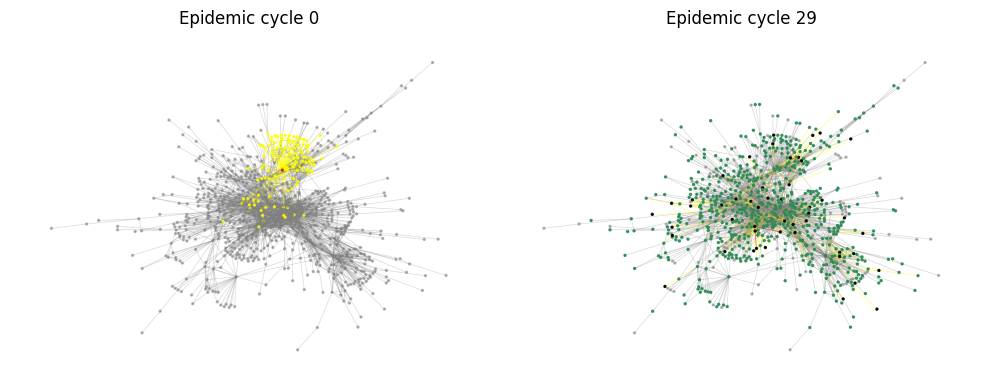

In [ ]:
got_covid(main_character)

Simulazione COVID-19: Numero di iterazioni: 25 - Morti totali: 34 - Infetti totali: 0 - Guariti totali: 649


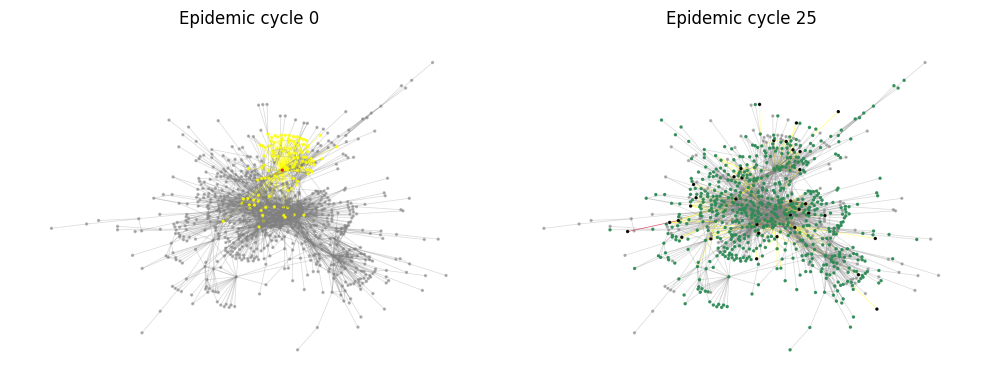

In [ ]:
got_covid(main_character)

Simulazione COVID-19: Numero di iterazioni: 26 - Morti totali: 45 - Infetti totali: 0 - Guariti totali: 659


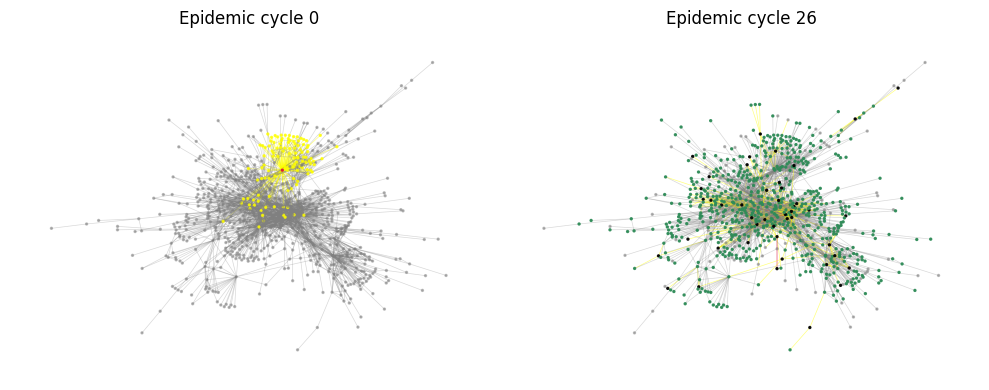

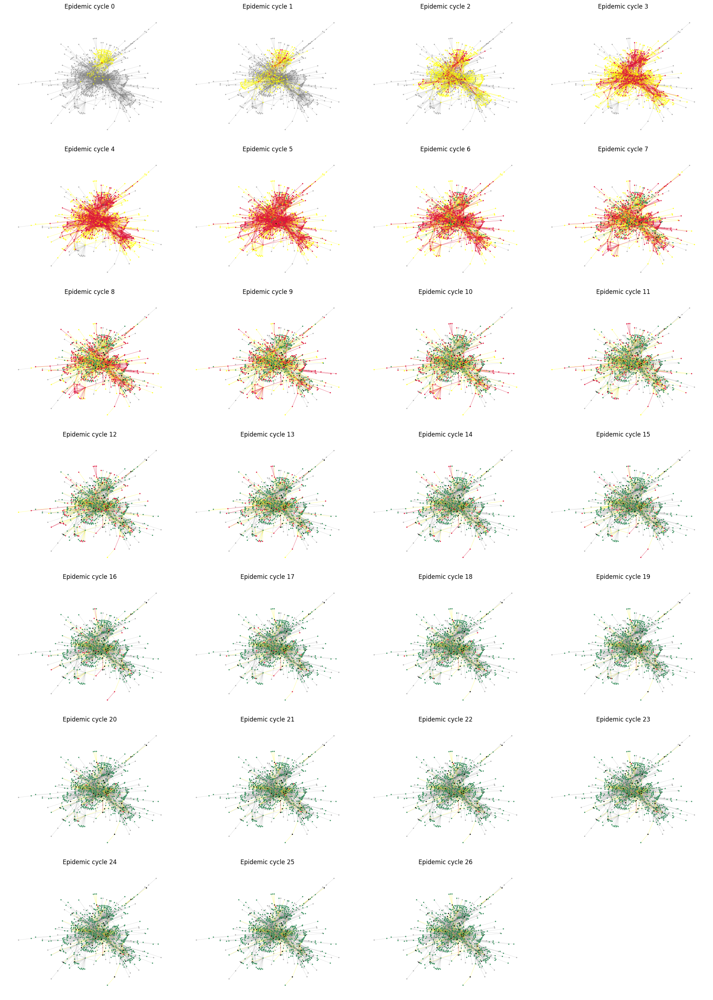

In [ ]:
got_covid(main_character, chronology=True)

**SIMULAZIONE PESTE NERA**

Simulazione Peste nera: Numero di iterazioni: 5 - Morti totali: 73 - Infetti totali: 556 - Guariti totali: 0


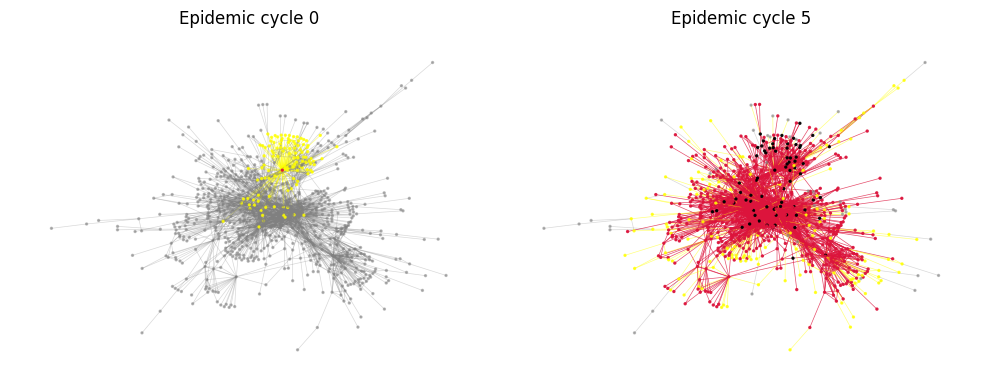

In [ ]:
got_plague(main_character)

In [ ]:
got_plague(main_character)

In [ ]:
got_plague(main_character, chronology=True)

###*Visualizzazione analisi*

### Simulazioni con 3 peronaggi del quarto quartile

In [ ]:
# Get closeness centrality values for all nodes
closeness_centralities = [G.nodes[node]['closnesscentrality'] for node in G.nodes]

# Calculate the 3rd quartile (start of the 4th quartile)
quartile_3 = np.quantile(closeness_centralities, 0.75)

# Filter nodes in the 4th quartile and select 3 random nodes
characters = random.sample(
    [node for node in G.nodes if G.nodes[node]['closnesscentrality'] >= quartile_3],
    3
)

print(f"Selected characters: {characters}")

**SIMULAZIONE COVID e PESTE PRIMO PERSONAGGIO**

Simulazione COVID-19: Numero di iterazioni: 26 - Morti totali: 40 - Infetti totali: 0 - Guariti totali: 661


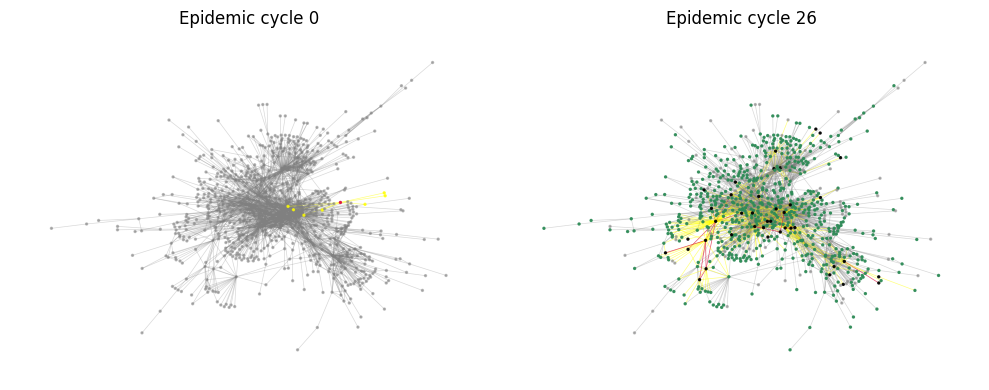

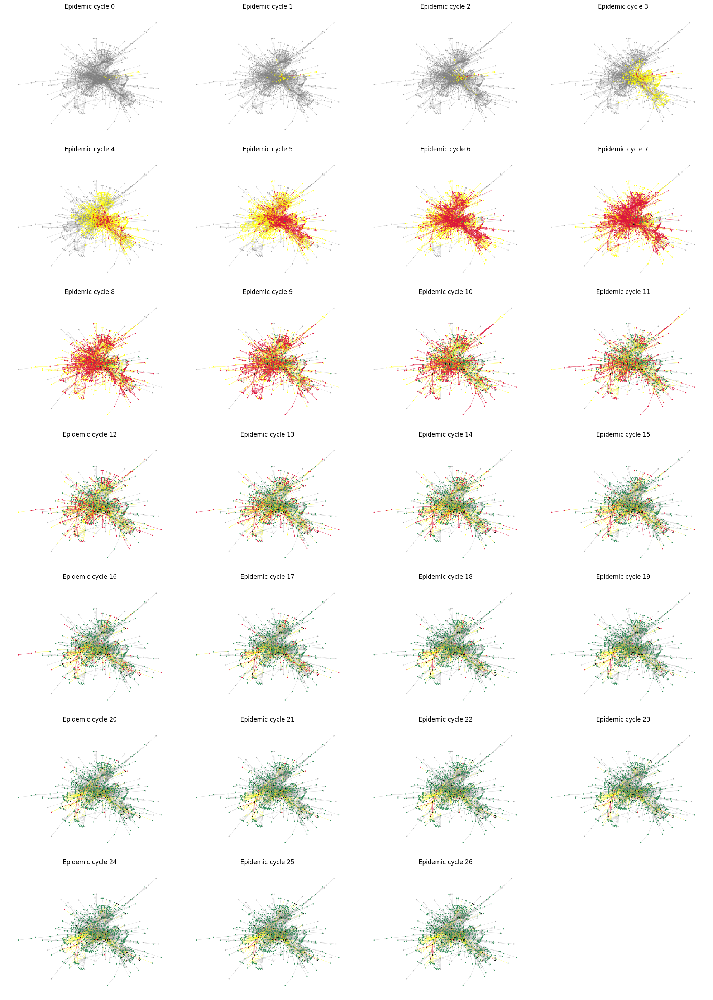

In [ ]:
got_covid([characters[0]], chronology=True)

In [ ]:
got_plague([characters[0]], chronology=True)

**SIMULAZIONE COVID e PESTE SECONFO PERSONAGGIO**

In [ ]:
got_covid([characters[1]])

In [ ]:
got_plague([characters[1]])

**SIMULAZIONE COVID e PESTE PRIMO TERZO**

In [ ]:
got_covid([characters[2]])

In [ ]:
got_plague([characters[2]])

### Simulazioni con 3 peronaggi del terzo quartile

In [ ]:
# Get closeness centrality values for all nodes
closeness_centralities = [G.nodes[node]['closnesscentrality'] for node in G.nodes]

# Calculate the 2nd quartile (start of the 3rd quartile) and 3rd quartile (end of the 3rd quartile)
quartile_2 = np.quantile(closeness_centralities, 0.50)
quartile_3 = np.quantile(closeness_centralities, 0.75)


# Filter nodes in the 3rd quartile and select 3 random nodes
characters = random.sample(
    [node for node in G.nodes if quartile_2 <= G.nodes[node]['closnesscentrality'] < quartile_3],
    3
)

print(f"Selected characters: {characters}")

**SIMULAZIONE COVID e PESTE PRIMO PERSONAGGIO**

Simulazione COVID-19: Numero di iterazioni: 26 - Morti totali: 46 - Infetti totali: 0 - Guariti totali: 645


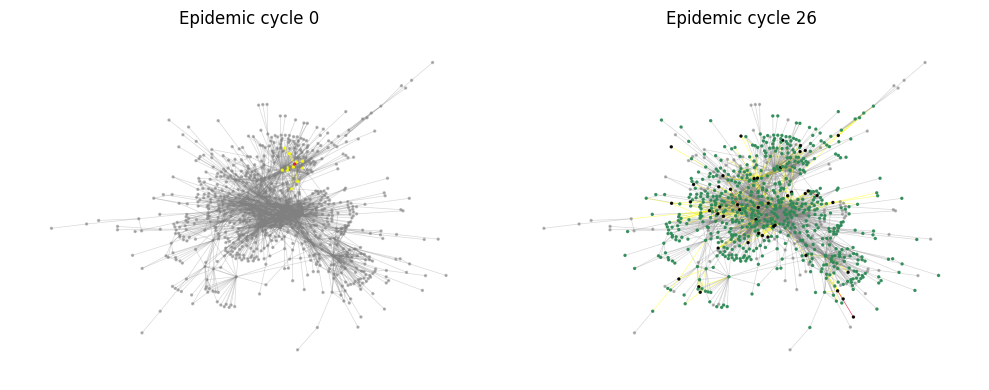

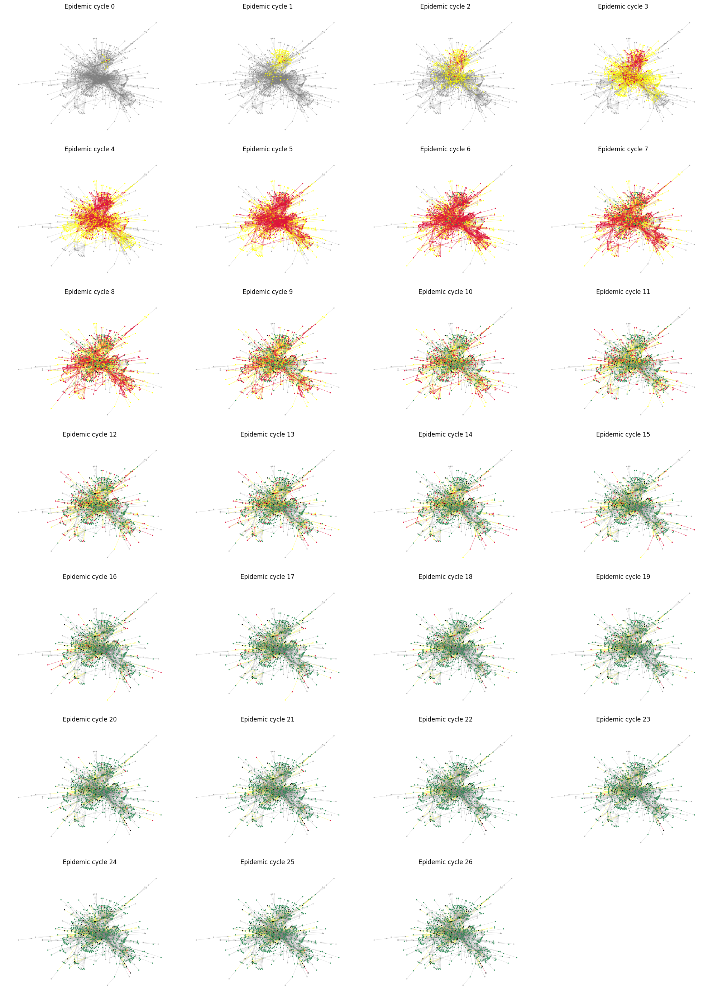

In [ ]:
got_covid([characters[0]], chronology=True)

Simulazione Peste nera: Numero di iterazioni: 9 - Morti totali: 70 - Infetti totali: 543 - Guariti totali: 0


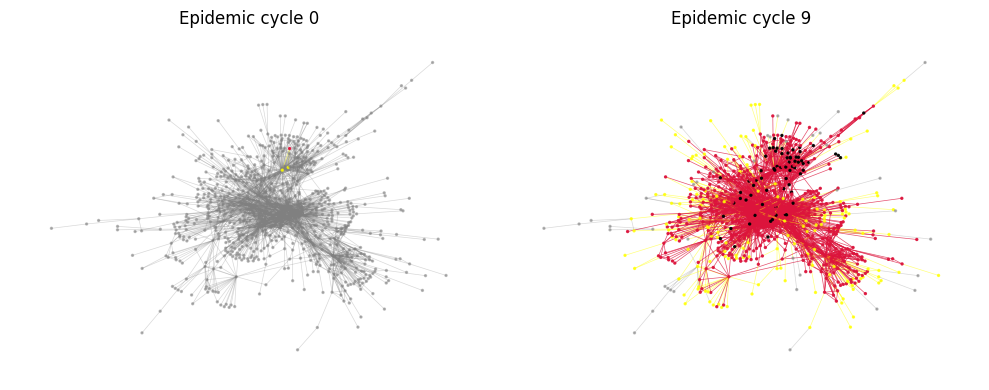

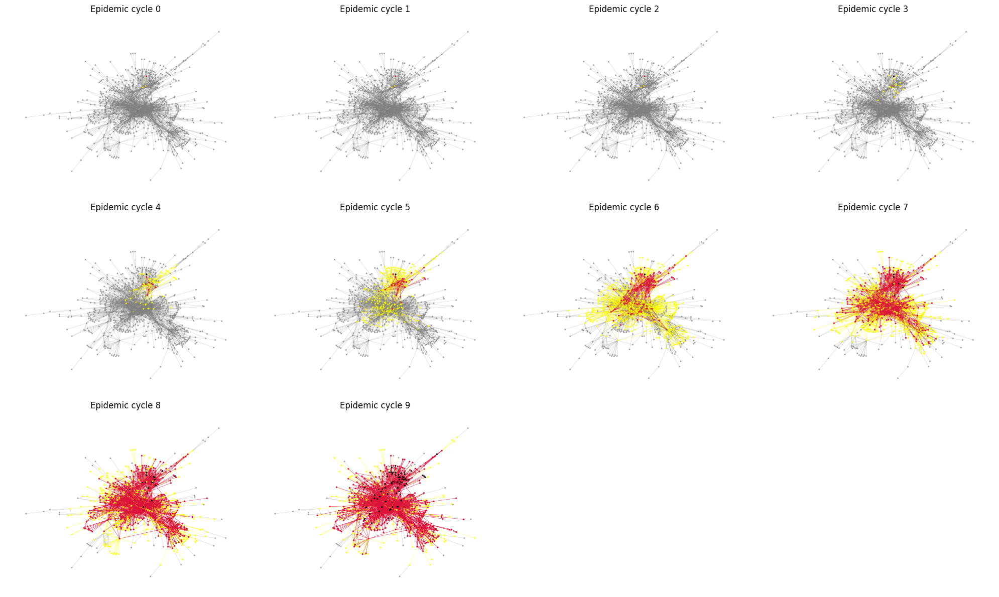

In [ ]:
got_plague([characters[0]], chronology=True)

**SIMULAZIONE COVID e PESTE SECONFO PERSONAGGIO**

Simulazione COVID-19: Numero di iterazioni: 36 - Morti totali: 39 - Infetti totali: 0 - Guariti totali: 651


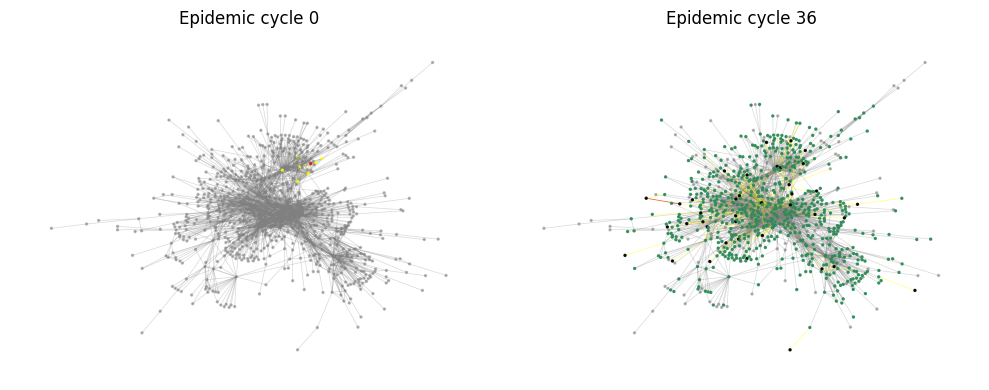

In [ ]:
got_covid([characters[1]])

Simulazione Peste nera: Numero di iterazioni: 7 - Morti totali: 106 - Infetti totali: 533 - Guariti totali: 0


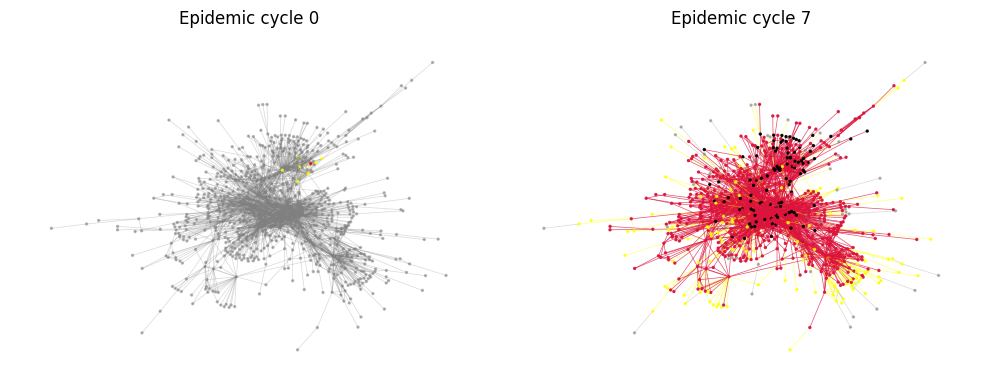

In [ ]:
got_plague([characters[1]])

**SIMULAZIONE COVID e PESTE PRIMO TERZO**

Simulazione COVID-19: Numero di iterazioni: 36 - Morti totali: 34 - Infetti totali: 0 - Guariti totali: 642


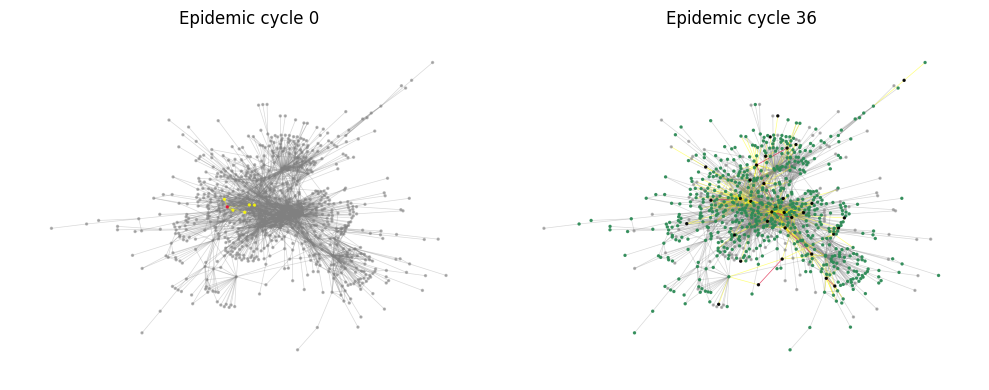

In [ ]:
got_covid([characters[2]])

Simulazione Peste nera: Numero di iterazioni: 6 - Morti totali: 133 - Infetti totali: 524 - Guariti totali: 0


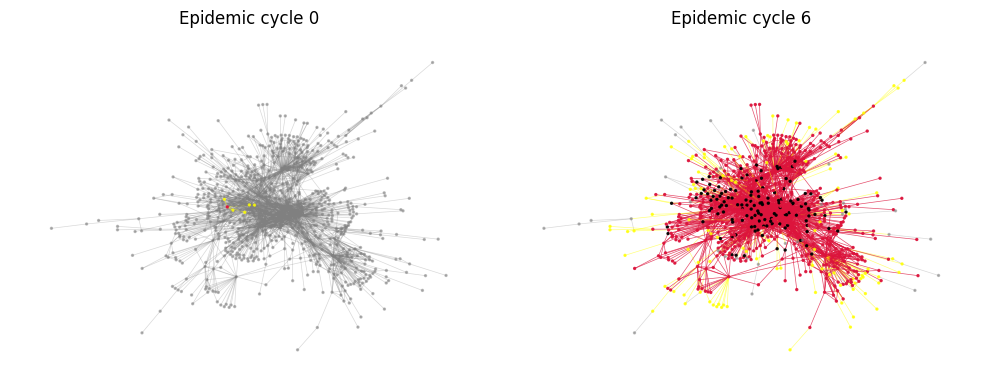

In [ ]:
got_plague([characters[2]])

### Simulazioni con 3 peronaggi del secondo quartile

In [ ]:
# Get closeness centrality values for all nodes
closeness_centralities = [G.nodes[node]['closnesscentrality'] for node in G.nodes]

# Calculate the 2nd quartile (start of the 3rd quartile) and 3rd quartile (end of the 3rd quartile)
quartile_2 = np.quantile(closeness_centralities, 0.25)
quartile_3 = np.quantile(closeness_centralities, 0.50)


# Filter nodes in the 3rd quartile and select 3 random nodes
characters = random.sample(
    [node for node in G.nodes if quartile_2 <= G.nodes[node]['closnesscentrality'] < quartile_3],
    3
)

print(f"Selected characters: {characters}")

Selected characters: ['Poxy-Tym', 'Jeyne-Heddle', 'Qezza']


**SIMULAZIONE COVID e PESTE PRIMO PERSONAGGIO**

Simulazione COVID-19: Numero di iterazioni: 24 - Morti totali: 52 - Infetti totali: 0 - Guariti totali: 638


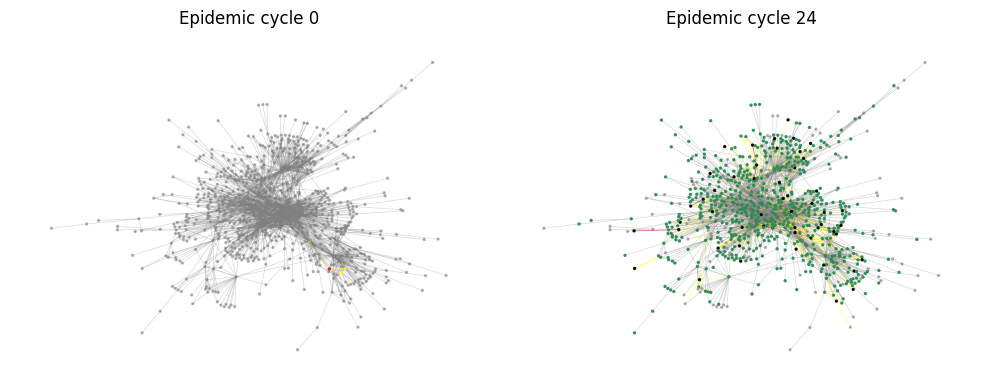

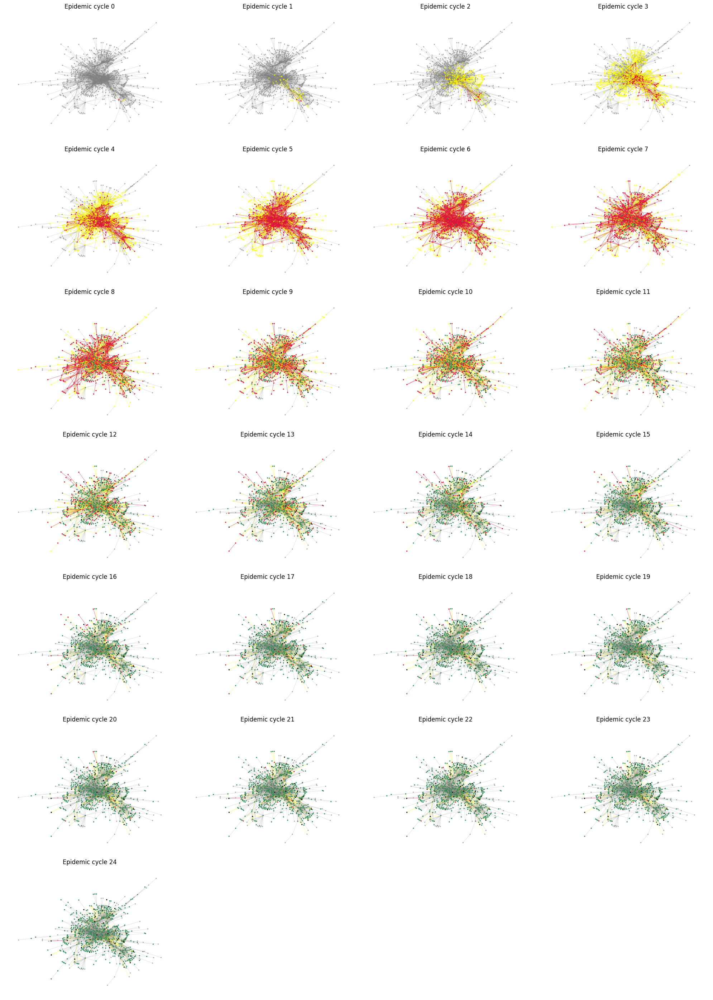

In [ ]:
got_covid([characters[0]], chronology=True)

Simulazione Peste nera: Numero di iterazioni: 7 - Morti totali: 50 - Infetti totali: 576 - Guariti totali: 0


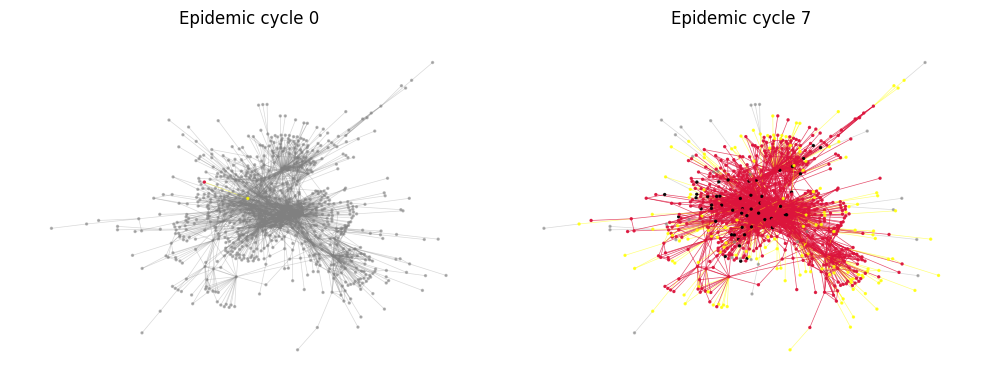

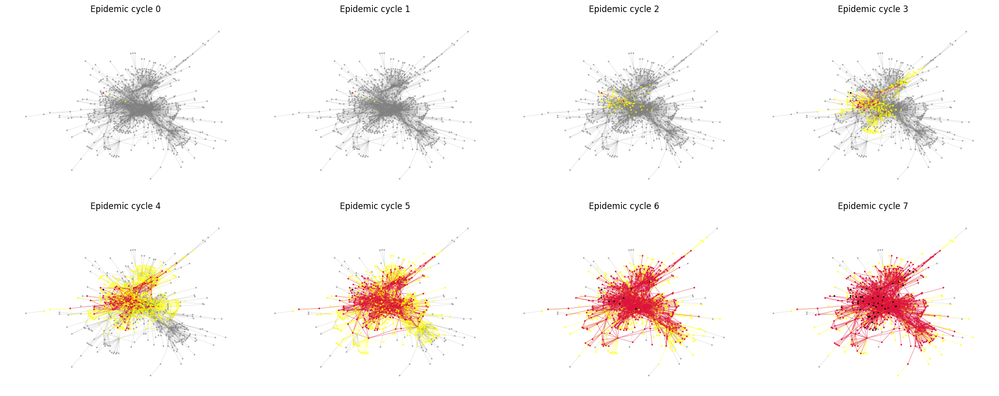

In [ ]:
got_plague([characters[0]], chronology=True)

**SIMULAZIONE COVID e PESTE SECONFO PERSONAGGIO**

Simulazione COVID-19: Numero di iterazioni: 4 - Morti totali: 0 - Infetti totali: 0 - Guariti totali: 1


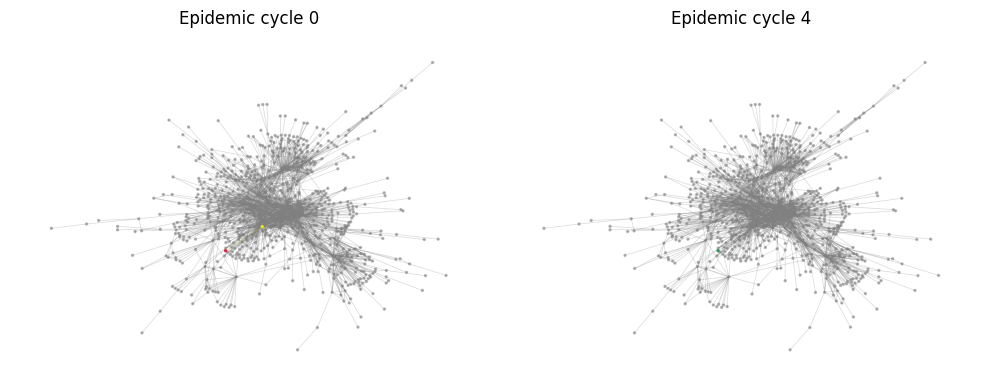

In [ ]:
got_covid([characters[1]])

Simulazione Peste nera: Numero di iterazioni: 8 - Morti totali: 61 - Infetti totali: 554 - Guariti totali: 0


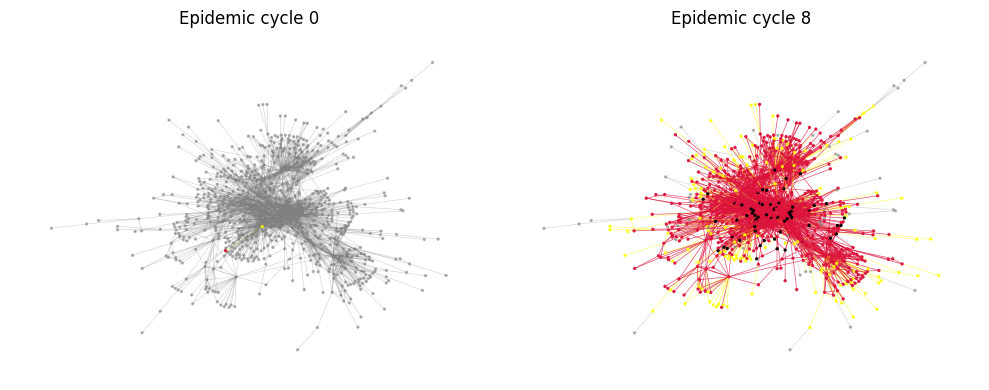

In [ ]:
got_plague([characters[1]])

**SIMULAZIONE COVID e PESTE PRIMO TERZO**

Simulazione COVID-19: Numero di iterazioni: 27 - Morti totali: 36 - Infetti totali: 0 - Guariti totali: 655


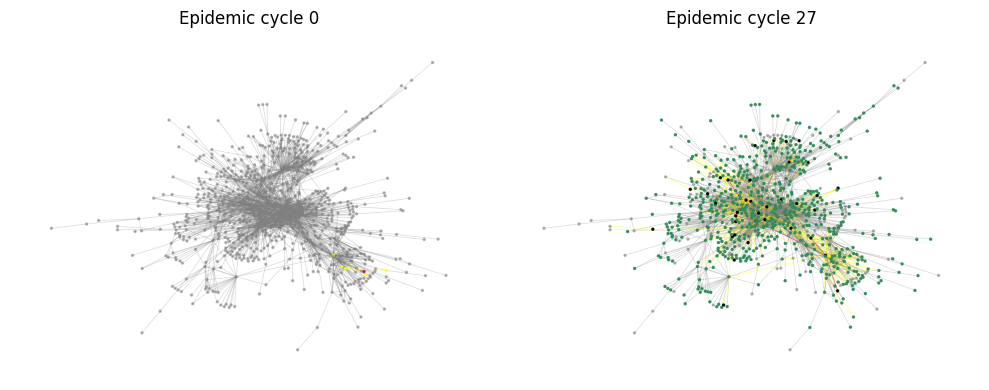

In [ ]:
got_covid([characters[2]])

Simulazione Peste nera: Numero di iterazioni: 7 - Morti totali: 90 - Infetti totali: 537 - Guariti totali: 0


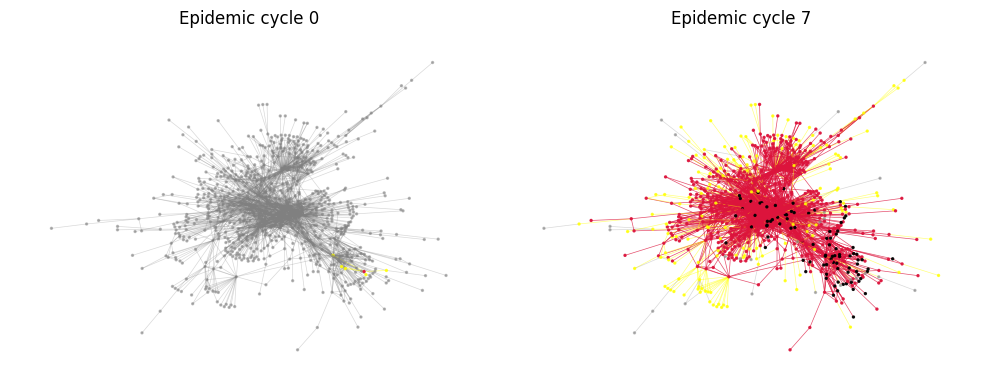

In [ ]:
got_plague([characters[2]])

### Simulazioni con 3 peronaggi del primo quartile

In [ ]:
# Get closeness centrality values for all nodes
closeness_centralities = [G.nodes[node]['closnesscentrality'] for node in G.nodes]

# Calculate the 2nd quartile (start of the 3rd quartile) and 3rd quartile (end of the 3rd quartile)
quartile_2 = np.quantile(closeness_centralities, 0.0)
quartile_3 = np.quantile(closeness_centralities, 0.25)


# Filter nodes in the 3rd quartile and select 3 random nodes
characters = random.sample(
    [node for node in G.nodes if quartile_2 <= G.nodes[node]['closnesscentrality'] < quartile_3],
    3
)

print(f"Selected characters: {characters}")

Selected characters: ['Hother-Umber', 'Jared-Frey', 'Steffon-Varner']


**SIMULAZIONE COVID e PESTE PRIMO PERSONAGGIO**

Simulazione COVID-19: Numero di iterazioni: 30 - Morti totali: 47 - Infetti totali: 0 - Guariti totali: 645


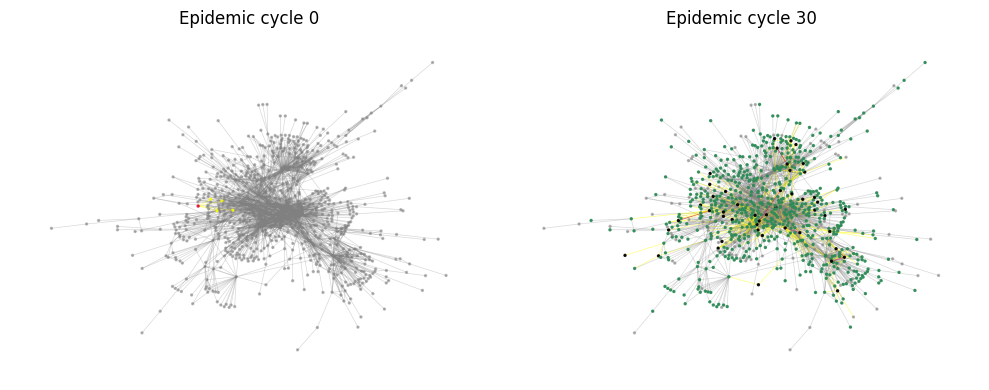

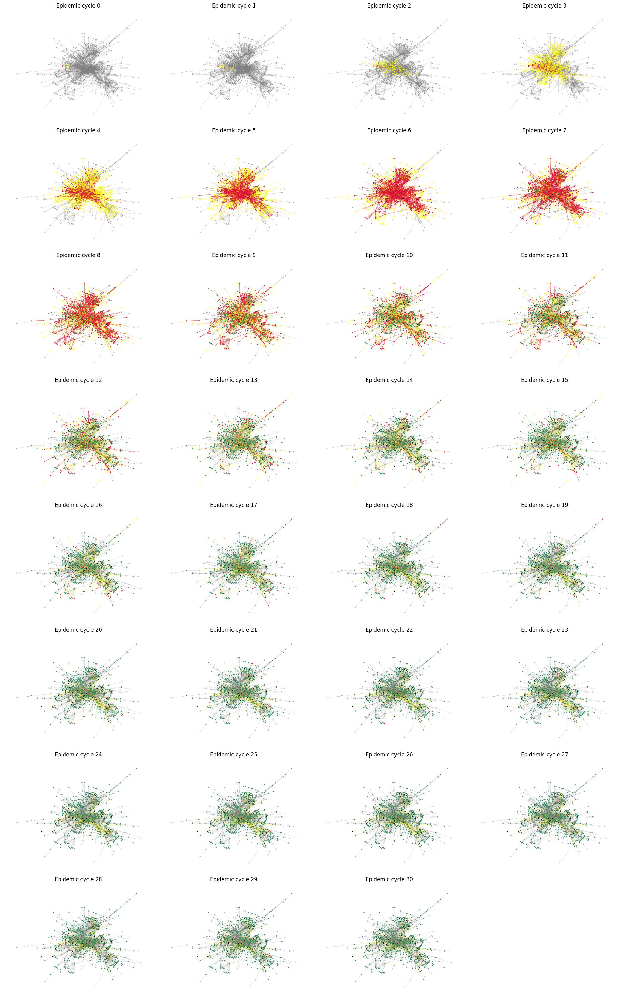

In [ ]:
got_covid([characters[0]], chronology=True)

Simulazione Peste nera: Numero di iterazioni: 6 - Morti totali: 44 - Infetti totali: 591 - Guariti totali: 0


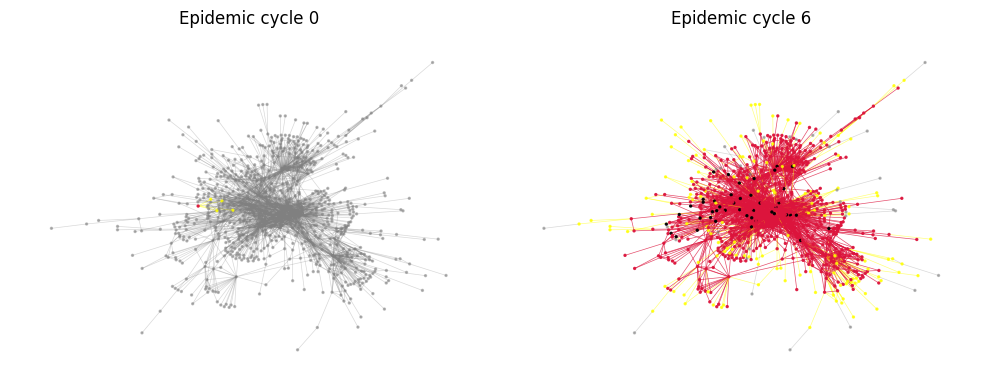

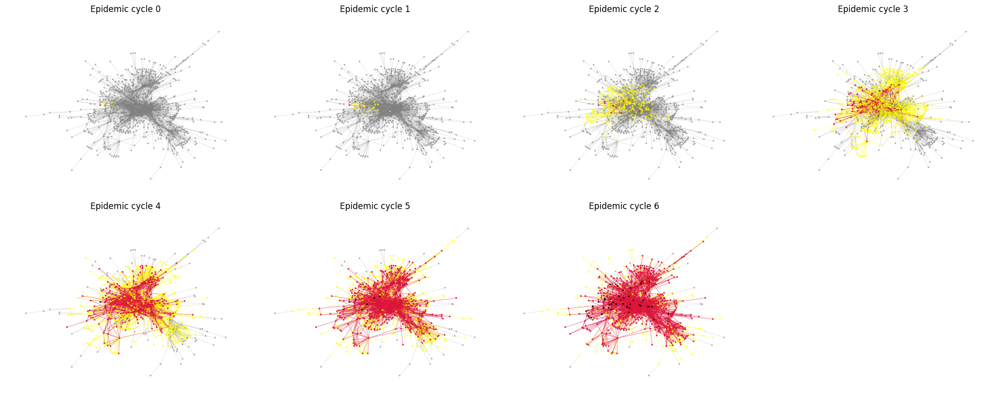

In [ ]:
got_plague([characters[0]], chronology=True)

**SIMULAZIONE COVID e PESTE SECONDO PERSONAGGIO**

Simulazione COVID-19: Numero di iterazioni: 31 - Morti totali: 50 - Infetti totali: 0 - Guariti totali: 621


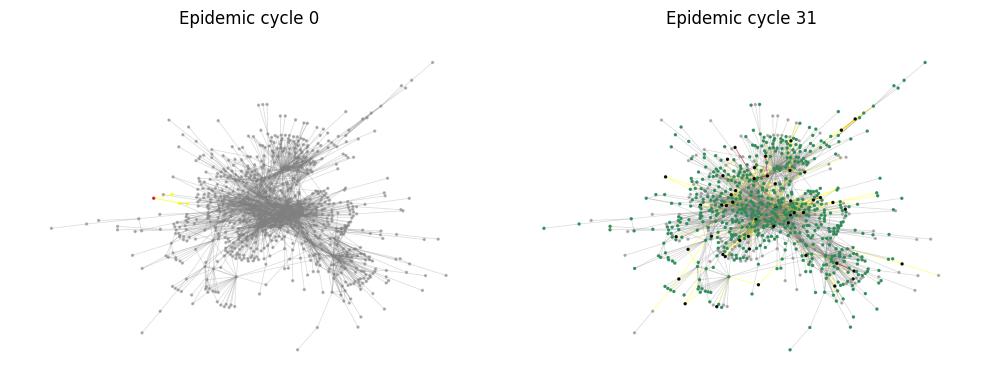

In [ ]:
got_covid([characters[1]])

Simulazione Peste nera: Numero di iterazioni: 10 - Morti totali: 94 - Infetti totali: 544 - Guariti totali: 0


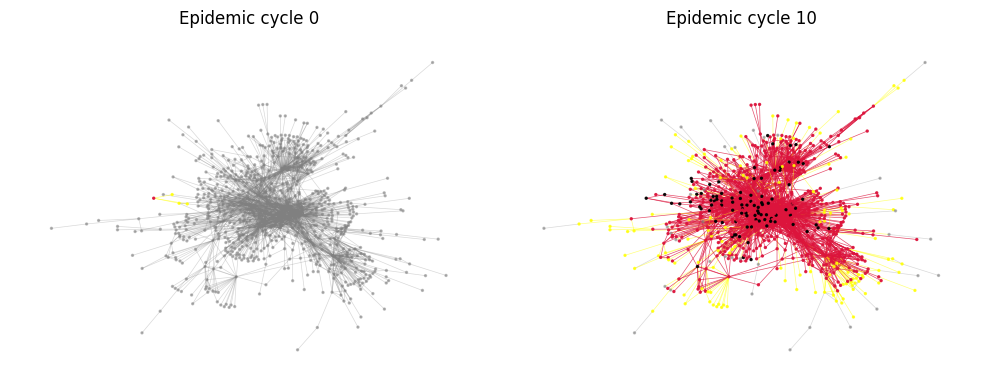

In [ ]:
got_plague([characters[1]])

**SIMULAZIONE COVID e PESTE PRIMO TERZO**

Simulazione COVID-19: Numero di iterazioni: 3 - Morti totali: 0 - Infetti totali: 0 - Guariti totali: 1


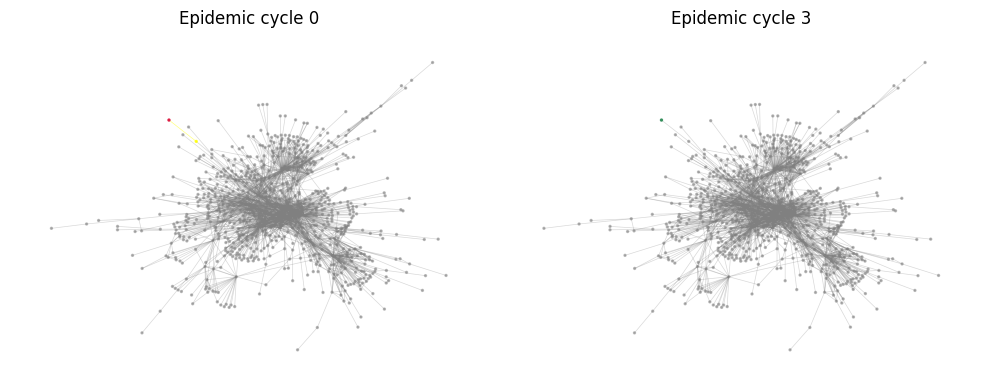

In [ ]:
got_covid([characters[2]])

Simulazione Peste nera: Numero di iterazioni: 7 - Morti totali: 2 - Infetti totali: 0 - Guariti totali: 0


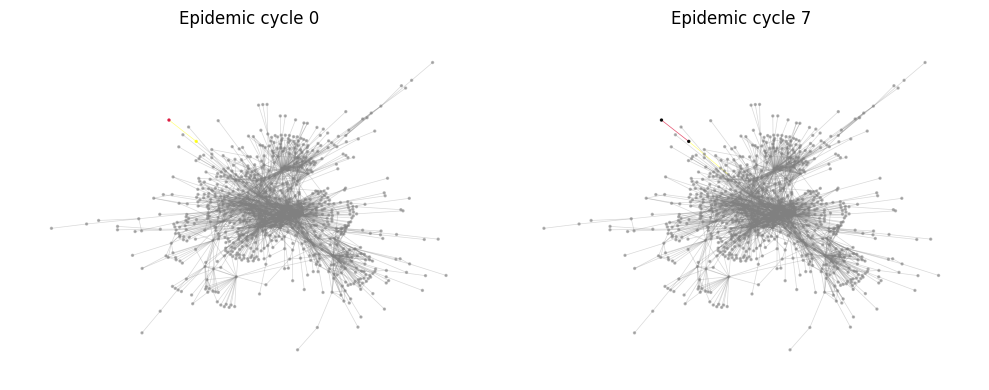

In [ ]:
got_plague([characters[2]])

###*Valutazione complessice anlisi*

In [ ]:
import torch
import pandas as pd
import os

save_dir = '/content/drive/MyDrive/social_network/got_new/dati/'
# Percorsi dei file di output
covid_file_path =  os.path.join(save_dir, 'covid_results.csv')
plague_file_path = os.path.join(save_dir, 'plague_results.csv')

In [ ]:
def classify_epidemic(total_dead, total_cured, total_infected, total_population):
    """
    Classifies the epidemic based on the provided data, using estimated percentages.

    Args:
        total_dead (int): Total number of deaths.
        total_cured (int): Total number of cured individuals.
        total_infected (int): Total number of infected individuals.
        total_population (int): Total population.

    Returns:
        str: Label classifying the epidemic.
    """
    if total_population == 0:
        return "Popolazione Non Definita"

    # Calculate percentages and round to nearest 10
    dead_percentage = round(total_dead / total_population * 100, -1)
    cured_percentage = round(total_cured / total_population * 100, -1)
    infected_percentage = round(total_infected / total_population * 100, -1)

    # Create label string
    label = f"{int(infected_percentage)}-{int(dead_percentage)}-{int(cured_percentage)}"

    return label

In [ ]:
def analyze_epidemics_for_characters_gpu(G, characters, covid_df, plague_df, num_simulations=50):
    """
    Esegue l'analisi delle epidemie utilizzando PyTorch per l'accelerazione GPU.

    Args:
        G (nx.Graph): Il grafo della rete.
        characters (list): Lista di ID dei nodi (personaggi) da analizzare.
        covid_df (pd.DataFrame): DataFrame Pandas per i risultati di COVID-19.
        plague_df (pd.DataFrame): DataFrame Pandas per i risultati della peste.
        num_simulations (int): Numero di simulazioni per ogni personaggio.

    Returns:
        tuple: Due DataFrame (COVID, Plague) aggiornati con i risultati delle simulazioni.
    """
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Usando dispositivo: {device}")

    # Convertire i dati del grafo in formati compatibili con PyTorch
    adjacency_matrix = torch.tensor(nx.adjacency_matrix(G).todense(), device=device, dtype=torch.float32)
    num_nodes = adjacency_matrix.shape[0]

    # Risultati
    covid_results = []
    plague_results = []

    # Simula le epidemie per ogni personaggio
    for character in characters:
        initial_state = torch.zeros(num_nodes, device=device)

        character_index = list(G.nodes()).index(character)
        initial_state[character_index] = 1  # Infetta il nodo iniziale

        for sim in range(num_simulations):
            # Simulazione COVID-19
            step, total_dead, total_cured, total_infected, infected_array, dead_array, cured_array = simulate_epidemic_gpu(
                adjacency_matrix, initial_state, contagion_prob=0.2, mortality_rate=0.02, recovery_prob=0.3,
                recovery_time=2, max_dead_or_infected=0.75, device=device
            )

            covid_row = {
                'Character': character,
                'Simulation': sim + 1,
                'Avg_Steps': step,
                'Total_Dead': total_dead,
                'Total_Cured': total_cured,
                'Total_Infected': total_infected,
                **{f'Dead_{i+1}': dead_array[i] for i in range(len(dead_array))},
                **{f'Cured_{i+1}': cured_array[i] for i in range(len(cured_array))},
                **{f'Infected_{i+1}': infected_array[i] for i in range(len(infected_array))}
            }
            covid_results.append(covid_row)

            # Simulazione Peste Nera
            step, total_dead, total_cured, total_infected, infected_array, dead_array, cured_array = simulate_epidemic_gpu(
                adjacency_matrix, initial_state, contagion_prob=0.3, mortality_rate=0.5, recovery_prob=0.05,
                recovery_time=7, max_dead_or_infected=0.75, device=device
            )

            plague_row = {
                'Character': character,
                'Simulation': sim + 1,
                'Avg_Steps': step,
                'Total_Dead': total_dead,
                'Total_Cured': total_cured,
                'Total_Infected': total_infected,
                **{f'Dead_{i+1}': dead_array[i] for i in range(len(dead_array))},
                **{f'Cured_{i+1}': cured_array[i] for i in range(len(cured_array))},
                **{f'Infected_{i+1}': infected_array[i] for i in range(len(infected_array))}
            }
            plague_results.append(plague_row)

    # Creazione dei DataFrame
    new_covid_df = pd.DataFrame(covid_results)
    new_plague_df = pd.DataFrame(plague_results)

    covid_df = pd.read_csv(covid_file_path)
    plague_df = pd.read_csv(plague_file_path)

    covid_df = pd.concat([covid_df, new_covid_df], ignore_index=True)
    plague_df = pd.concat([plague_df, new_plague_df], ignore_index=True)

    return covid_df, plague_df

In [ ]:
def simulate_epidemic_gpu(
    adjacency_matrix, initial_state, contagion_prob=0.15, mortality_rate=0.03,
    recovery_prob=0.1, recovery_time=3, max_dead_or_infected=0.9, device="cuda"
):
    """
    Simula un'epidemia utilizzando PyTorch per accelerazione su GPU.

    Args:
        adjacency_matrix (torch.Tensor): Matrice di adiacenza del grafo (NxN).
        initial_state (torch.Tensor): Stato iniziale dei nodi (1 = infetto, 0 = sano).
        contagion_prob (float): Probabilità base di contagio.
        mortality_rate (float): Probabilità base di morte.
        recovery_prob (float): Probabilità base di guarigione.
        recovery_time (int): Tempo minimo da cui un nodo deve essere infetto per guarire.
        max_dead_or_infected (float): Percentuale di stop della simulazione.
        device (str): "cuda" per GPU o "cpu" per CPU.

    Returns:
        tuple: Numero di iterazioni, morti totali, guariti totali, infetti totali,
               lista infetti per step, lista morti per step, lista guariti per step.
    """
    # Configura il dispositivo
    adjacency_matrix = adjacency_matrix.to(device)
    num_nodes = adjacency_matrix.shape[0]

    # Stato iniziale
    state = initial_state.to(device)  # 0 = sano, 1 = infetto, 2 = morto, 3 = guarito
    infection_time = torch.zeros(num_nodes, device=device)  # Tempo di infezione per ogni nodo

    # Storia della simulazione
    infected_array = [torch.sum(state == 1).item()]
    dead_array = [torch.sum(state == 2).item()]
    cured_array = [torch.sum(state == 3).item()]

    step = 0
    while step <= 100:
        step += 1
        new_state = state.clone()

        # Identifica nodi infetti
        infected_nodes = (state == 1).nonzero(as_tuple=True)[0]

        if infected_nodes.numel() == 0:
            break  # Nessun nodo infetto: fermare la simulazione

        # Calcola il contagio per i nodi sani
        for node in infected_nodes:
            # Vicini del nodo infetto
            neighbors = adjacency_matrix[node].nonzero(as_tuple=True)[0]

            # Stati dei vicini
            neighbors_states = state[neighbors]

            # Solo i nodi sani possono essere infettati
            healthy_neighbors = neighbors[neighbors_states == 0]

            if healthy_neighbors.numel() > 0:
                # Numero di vicini morti
                dead_neighbors = torch.sum(state[neighbors] == 2)
                dead_effect = dead_neighbors / max(len(neighbors), 1)  # Evita divisione per 0

                # Contagio con probabilità aggiuntiva
                infection_probs = torch.rand(healthy_neighbors.shape[0], device=device)
                adjusted_contagion = contagion_prob + dead_effect

                # Infetta i nodi con probabilità maggiore del contagio
                new_infections = infection_probs < adjusted_contagion
                new_state[healthy_neighbors[new_infections]] = 1

        # Aggiorna il tempo di infezione per i nodi infetti
        infection_time[state == 1] += 1

        # Gestione guarigione e morte
        recovery_candidates = (state == 1) & (infection_time >= recovery_time)
        recovery_probs = torch.rand(num_nodes, device=device)
        recovery_modifier = recovery_prob
        recovered = recovery_candidates & (recovery_probs < recovery_modifier)

        death_probs = torch.rand(num_nodes, device=device)
        died = (state == 1) & (death_probs < mortality_rate)

        # Aggiorna gli stati
        new_state[recovered] = 3  # Guariti
        new_state[died] = 2  # Morti

        # Ferma la simulazione se la pandemia è ferma
        if torch.equal(state, new_state):
            break

        # Aggiorna lo stato e la storia
        state = new_state
        infected_array.append(torch.sum(state == 1).item())
        dead_array.append(torch.sum(state == 2).item())
        cured_array.append(torch.sum(state == 3).item())

        # Controlla condizione di arresto
        current_dead_or_infected = (torch.sum(state == 1) + torch.sum(state == 2)).item() / num_nodes
        if current_dead_or_infected >= max_dead_or_infected:
            break

    # Calcola totali dall'ultima iterazione
    total_dead = dead_array[-1]
    total_cured = cured_array[-1]
    total_infected = infected_array[-1]

    return step, total_dead, total_cured, total_infected, infected_array, dead_array, cured_array

In [ ]:
def run_simulation(G, covid_df, plague_df, num_simulations=50, covid_file_path='covid_results.csv', plague_file_path='plague_results.csv'):
    """
    Esegue simulazioni e salva i risultati in file CSV.

    :param G: Il grafo NetworkX.
    :param covid_df: DataFrame Pandas per i risultati delle simulazioni COVID.
    :param plague_df: DataFrame Pandas per i risultati delle simulazioni Plague.
    :param num_simulations: Numero totale di simulazioni da eseguire.
    :param covid_file_path: Percorso per salvare il file CSV dei risultati COVID.
    :param plague_file_path: Percorso per salvare il file CSV dei risultati Plague.
    """
    for i in range(num_simulations):
        if(i%100==0):
          print(f"Esecuzione simulazione {i}/{num_simulations}")

        # Simulazione: aggiorna i DataFrame (aggiungi qui la logica di simulazione)
        covid_df, plague_df = analyze_epidemics_for_characters_gpu(G, G.nodes(), covid_df=covid_df, plague_df=plague_df, num_simulations=1)

        # Classifica i risultati e aggiorna le etichette
        covid_df['Etichetta'] = covid_df.apply(lambda row: classify_epidemic(
            row['Total_Dead'], row['Total_Cured'], row['Total_Infected'], len(G.nodes())
        ), axis=1)

        plague_df['Etichetta'] = plague_df.apply(lambda row: classify_epidemic(
            row['Total_Dead'], row['Total_Cured'], row['Total_Infected'], len(G.nodes())
        ), axis=1)

        # Salva i risultati parziali su CSV
        covid_df.to_csv(covid_file_path, index=False)
        plague_df.to_csv(plague_file_path, index=False)

In [ ]:
save_dir = '/content/drive/MyDrive/social_network/got_new/dati/'
# Percorsi dei file di output
covid_file_path =  os.path.join(save_dir, 'covid_results.csv')
plague_file_path = os.path.join(save_dir, 'plague_results.csv')

# Carica i dataset
covid_df = pd.read_csv(covid_file_path)
plague_df = pd.read_csv(plague_file_path)
#covid_df = pd.DataFrame()
#plague_df = pd.DataFrame()

# Parametri del grafo (esempio, sostituisci con il tuo grafo)
import networkx as nx

# Esegui simulazioni
#run_simulation(G, covid_df, plague_df, num_simulations=500, covid_file_path=covid_file_path, plague_file_path=plague_file_path)